<a href="https://colab.research.google.com/github/Pyroxene889/Store-Sales/blob/Ikram/sales_RL_RF.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [111]:
!git clone https://github.com/Pyroxene889/Store-Sales

fatal: destination path 'Store-Sales' already exists and is not an empty directory.


In [112]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px

import seaborn as sns
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from plotly.offline import init_notebook_mode, iplot

In [113]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [114]:
df_train = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Cas_Etude/data_train.csv')

In [115]:
df_test = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Cas_Etude/data_test.csv')

# Data Visualization


In [116]:
fig_type_holiday = px.histogram(df_train, x = "type_holiday", color = "type_holiday", template = "plotly_dark")
fig_type_holiday.show()

In [117]:
# Conversion de la variable type_batiment en une variable binaire
new_df_train = df_train.copy()
new_df_test = df_test.copy()
new_df_train['type_holiday'] = new_df_train['type_holiday'].map({'work': 0, 'Holiday':1,'Work Day': 2, 'Additional':3, 'Event':4, 'Transfer':5, 'Bridge':6})
new_df_test['type_holiday'] = new_df_test['type_holiday'].map({'work': 0, 'Holiday':1,'Work Day': 2, 'Additional':3, 'Event':4, 'Transfer':5, 'Bridge':6})
new_df_train.head()

,date,store_nbr,family,sales,onpromotion,city,state,type_store,cluster,type_holiday,locale,dcoilwtico,transactions
0,2013-01-01,25,AUTOMOTIVE,0.000,0,Salinas,Santa Elena,D,1,1,National,93.14,770
1,2013-01-01,25,SEAFOOD,0.000,0,Salinas,Santa Elena,D,1,1,National,93.14,770
2,2013-01-01,25,SCHOOL AND OFFICE SUPPLIES,0.000,0,Salinas,Santa Elena,D,1,1,National,93.14,770
3,2013-01-01,25,PRODUCE,0.000,0,Salinas,Santa Elena,D,1,1,National,93.14,770
4,2013-01-01,25,PREPARED FOODS,37.847,0,Salinas,Santa Elena,D,1,1,National,93.14,770


In [118]:
# Conversion de la variable type_batiment en une variable binaire
new_df_train['locale'] = new_df_train['locale'].map({'National': 0, 'Regional':1,'Local': 2})
new_df_test['locale'] = new_df_test['locale'].map({'National': 0, 'Regional':1,'Local': 2})
new_df_train.head()

,date,store_nbr,family,sales,onpromotion,city,state,type_store,cluster,type_holiday,locale,dcoilwtico,transactions
0,2013-01-01,25,AUTOMOTIVE,0.000,0,Salinas,Santa Elena,D,1,1,0,93.14,770
1,2013-01-01,25,SEAFOOD,0.000,0,Salinas,Santa Elena,D,1,1,0,93.14,770
2,2013-01-01,25,SCHOOL AND OFFICE SUPPLIES,0.000,0,Salinas,Santa Elena,D,1,1,0,93.14,770
3,2013-01-01,25,PRODUCE,0.000,0,Salinas,Santa Elena,D,1,1,0,93.14,770
4,2013-01-01,25,PREPARED FOODS,37.847,0,Salinas,Santa Elena,D,1,1,0,93.14,770


In [119]:
fig_type_store = px.histogram(df_train, x = "type_store", color = "type_store", template = "plotly_dark")
fig_type_store.show()

In [120]:
# Conversion de la variable type_batiment en une variable binaire
new_df_train['type_store'] = new_df_train['type_store'].map({'A': 0, 'B':1,'C': 2, 'D':3, 'E':4})
new_df_test['type_store'] = new_df_test['type_store'].map({'A': 0, 'B':1,'C': 2, 'D':3, 'E':4})
new_df_train.head()

,date,store_nbr,family,sales,onpromotion,city,state,type_store,cluster,type_holiday,locale,dcoilwtico,transactions
0,2013-01-01,25,AUTOMOTIVE,0.000,0,Salinas,Santa Elena,3,1,1,0,93.14,770
1,2013-01-01,25,SEAFOOD,0.000,0,Salinas,Santa Elena,3,1,1,0,93.14,770
2,2013-01-01,25,SCHOOL AND OFFICE SUPPLIES,0.000,0,Salinas,Santa Elena,3,1,1,0,93.14,770
3,2013-01-01,25,PRODUCE,0.000,0,Salinas,Santa Elena,3,1,1,0,93.14,770
4,2013-01-01,25,PREPARED FOODS,37.847,0,Salinas,Santa Elena,3,1,1,0,93.14,770


In [122]:
new_df_test.head()

,store_nbr,family,onpromotion,city,state,type_store,cluster,type_holiday,locale,dcoilwtico
0,1,AUTOMOTIVE,0,Quito,Pichincha,3,13,0,0,46.8
1,42,CELEBRATION,0,Cuenca,Azuay,3,2,0,0,46.8
2,42,BREAD/BAKERY,12,Cuenca,Azuay,3,2,0,0,46.8
3,42,BOOKS,0,Cuenca,Azuay,3,2,0,0,46.8
4,42,BEVERAGES,19,Cuenca,Azuay,3,2,0,0,46.8


In [121]:
from sklearn.preprocessing import LabelEncoder

# Initialisez le codage
encoder = LabelEncoder()

# Appliquez le codage à la colonne 'family'
new_df_train['family_encoded'] = encoder.fit_transform(new_df_train['family'])
new_df_train['date_encoded'] = encoder.fit_transform(new_df_train['date'])

new_df_train['family_encoded'] = encoder.fit_transform(new_df_train['family'])
new_df_test['date_encoded'] = encoder.fit_transform(new_df_test['date'])

# Afficher les valeurs codées
#print(new_df_train['family_encoded'].value_counts())


KeyError: ignored

In [123]:
new_df_train.head()

,date,store_nbr,family,sales,onpromotion,city,state,type_store,cluster,type_holiday,locale,dcoilwtico,transactions,family_encoded,date_encoded
0,2013-01-01,25,AUTOMOTIVE,0.000,0,Salinas,Santa Elena,3,1,1,0,93.14,770,0,0
1,2013-01-01,25,SEAFOOD,0.000,0,Salinas,Santa Elena,3,1,1,0,93.14,770,32,0
2,2013-01-01,25,SCHOOL AND OFFICE SUPPLIES,0.000,0,Salinas,Santa Elena,3,1,1,0,93.14,770,31,0
3,2013-01-01,25,PRODUCE,0.000,0,Salinas,Santa Elena,3,1,1,0,93.14,770,30,0
4,2013-01-01,25,PREPARED FOODS,37.847,0,Salinas,Santa Elena,3,1,1,0,93.14,770,29,0


In [ ]:
new_df_test.head()

## Correlation

In [124]:
new_df_train = new_df_train.reset_index(drop = True)
new_df_train.head()

,date,store_nbr,family,sales,onpromotion,city,state,type_store,cluster,type_holiday,locale,dcoilwtico,transactions,family_encoded,date_encoded
0,2013-01-01,25,AUTOMOTIVE,0.000,0,Salinas,Santa Elena,3,1,1,0,93.14,770,0,0
1,2013-01-01,25,SEAFOOD,0.000,0,Salinas,Santa Elena,3,1,1,0,93.14,770,32,0
2,2013-01-01,25,SCHOOL AND OFFICE SUPPLIES,0.000,0,Salinas,Santa Elena,3,1,1,0,93.14,770,31,0
3,2013-01-01,25,PRODUCE,0.000,0,Salinas,Santa Elena,3,1,1,0,93.14,770,30,0
4,2013-01-01,25,PREPARED FOODS,37.847,0,Salinas,Santa Elena,3,1,1,0,93.14,770,29,0


In [126]:
df_qualitatif_train = new_df_train.drop(["date", "state", "city", "family", "cluster", "store_nbr", "locale"], axis = 1)
new_df_train = new_df_train.reset_index(drop = True)
cor = df_qualitatif_train.corr()

In [ ]:
df_qualitatif_test = new_df_test.drop(["date", "state", "city", "family", "cluster", "store_nbr", "locale"], axis = 1)


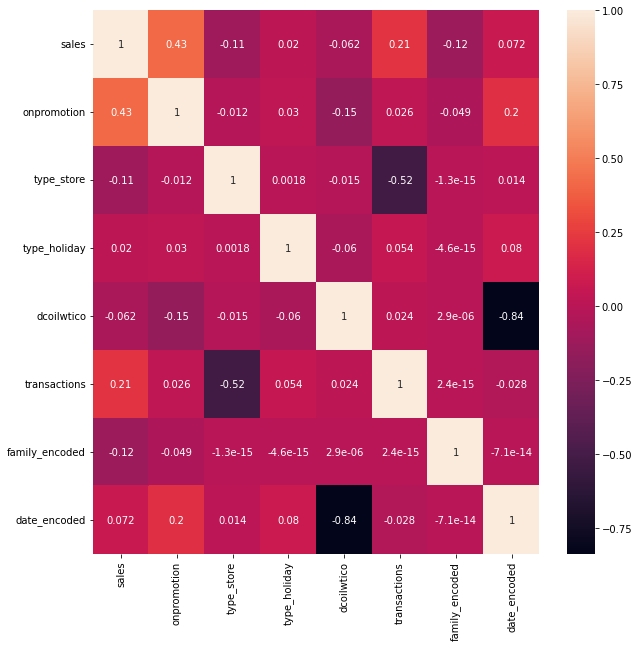

In [127]:
plt.figure(figsize = (10, 10))
sns.heatmap(cor, annot = True)

In [128]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# Régression Linéaire

## Training

In [129]:
df_qualitatif_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2805231 entries, 0 to 2805230
Data columns (total 8 columns):
 #   Column          Dtype  
---  ------          -----  
 0   sales           float64
 1   onpromotion     int64  
 2   type_store      int64  
 3   type_holiday    int64  
 4   dcoilwtico      float64
 5   transactions    int64  
 6   family_encoded  int64  
 7   date_encoded    int64  
dtypes: float64(2), int64(6)
memory usage: 171.2 MB


In [130]:
# Séparer les données en entrées (X) et sorties (y)
X = df_qualitatif_train.drop(columns=["sales"])
y = df_qualitatif_train.reset_index(drop = True)["sales"]

# Séparer les données en ensembles d'entraînement et de validation
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2)

# Entraîner le modèle de régression linéaire multiple
regressor = LinearRegression()
regressor.fit(X_train, y_train)

# Effectuer des prédictions sur l'ensemble de validation
y_pred = regressor.predict(X_val)



In [131]:
y_val.describe()

count    561047.000000
mean        389.595347
std        1155.040464
min           0.000000
25%           0.000000
50%          17.000000
75%         231.000000
max       87438.516000
Name: sales, dtype: float64

## Evaluation:

In [132]:
print('MSE :', mean_squared_error(y_val, y_pred))
print('RMSE :', np.sqrt(mean_squared_error(y_val, y_pred)))
print('MAE :', mean_absolute_error(y_val, y_pred))
print("R2:", regressor.score(X_val, y_val))

MSE : 1024736.1889524409
RMSE : 1012.292541191745
MAE : 449.1844610011713
R2: 0.23189878823257815


## Application aux données test

In [ ]:
X_test = df_qualitatif_test.drop(columns=["sales"])
df_qualitatif_test['sales_pred'] = y_pred = regressor.predict(X_test)

# Random Forest

## Training

In [133]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score

In [ ]:
# Entraînement du modèle Random Forest
model = RandomForestRegressor(n_estimators=100, random_state=0)
model.fit(X_train, y_train)

# Prédiction sur les données de test
y_pred_RF = model.predict(X_val)


## Evaluation

In [ ]:
# Évaluation du modèle
mse = mean_squared_error(y_val, y_pred)
r2 = r2_score(y_val, y_pred)

# Afficher les résultats
print('Mean Squared Error:', mse)
print('RMSE :', np.sqrt(mean_squared_error(y_val, y_pred)))
print('MAE :', mean_absolute_error(y_val, y_pred))
print('R2 Score:', r2)


# Visualisation des résultats avec un graphe
plt.scatter(y_val, y_pred_RF)
plt.xlabel('True Values')
plt.ylabel('Predictions')
plt.show()

## Application aux données test

In [ ]:
X_test = df_qualitatif_test.drop(columns=["sales"])
df_qualitatif_test['sales_pred'] = y_pred = model.predict(X_test)